## Table of Contents
- [Introduction](#scrollTo=ozaTnNFHc3od&line=1&uniqifier=1)
- [EDA Recap](#scrollTo=RGq092TiOeqU&line=3&uniqifier=1)
- [Baseline Model](#scrollTo=q9hyrPUk_iI6&line=1&uniqifier=1)
- [Results Interpretation and Analysis](#scrollTo=4201752a&line=1&uniqifier=1)
- [Final Model Pipeline Setup](#scrollTo=0d6c26aa&line=3&uniqifier=1)

# Introduction ([table of contents](#scrollTo=f4FNGNfNgslb&line=6&uniqifier=1))

*Although transformer models were originally used for text-based tasks, how effective are they at interpreting and generating music?*

In [ ]:
!pip install pretty_midi gdown midi2audio pydub seaborn scikit-learn tqdm pyFluidSynth music21
!apt-get update -y && apt-get install -y fluidsynth

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 36.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 4.8 MB/s eta 0:00:00
  Created wheel for pretty_midi: filename=pretty_midi-0.2.10-py3-none-any.whl size=5592286 sha256=6ff2e39015edfa504b17fd846a232e2b0fad36a15b2ce3aab8b2283dbc46fda0
  Stored in directory: /root/.cache/pip/wheels/e6/95/ac/15ceaeb2823b04d8e638fd1495357adb8d26c00ccac9d7782e
Successfully built pretty_midi
Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:6 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ Packages [77.5 kB]
Get:7 http://archive.ubuntu.com/

In [ ]:
# ─── imports + global settings ───────────────────────────────────
import os
import glob
import zipfile
import warnings
import random
import collections

from pathlib import Path
from tqdm import tqdm

import numpy as np
import pandas as pd
import pretty_midi
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf

from midi2audio import FluidSynth
from pydub import AudioSegment
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

warnings.filterwarnings("ignore")
sns.set_style("whitegrid")
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
random.seed(RANDOM_SEED)

In [ ]:
# ─── raw midi extraction ─────────────────────────

import gdown
if not os.path.isdir("clean_midi_folder"):
    file_id = "17zMFpcN4N5ntB5x8tzWrXjH1wHfSlbI-"
    gdown.download(f"https://drive.google.com/uc?id={file_id}",
                   "clean_midi.zip", quiet=False)
    with zipfile.ZipFile("clean_midi.zip","r") as z:
        z.extractall("clean_midi_folder")
DATA_DIR = "clean_midi_folder/clean_midi"
assert os.path.isdir(DATA_DIR), "Dataset folder not found!"
midi_files = glob.glob(os.path.join(DATA_DIR,"**","*.mid*"), recursive=True)
print("Total files found:", len(midi_files))

Downloading...
From (original): https://drive.google.com/uc?id=17zMFpcN4N5ntB5x8tzWrXjH1wHfSlbI-
From (redirected): https://drive.google.com/uc?id=17zMFpcN4N5ntB5x8tzWrXjH1wHfSlbI-&confirm=t&uuid=801c780f-9632-4f3a-be8b-5bfebfea7b57
To: /content/clean_midi.zip
100%|██████████| 243M/243M [00:02<00:00, 94.6MB/s]


Total files found: 17243


In [ ]:
# ─── load pre-generated csv with all data ───────────────────────────────────────
# you have to download the below file from the
# shared google drive folder and upload it before running!

df = pd.read_csv("clean_midi_meta.csv")
print("DataFrame shape:", df.shape)
df.head()

DataFrame shape: (16963, 6)


,tempo,duration,note_count,mean_velocity,mean_pitch,max_polyphony
0,199.910191,239.962009,9954,66.016074,55.050030,30
1,176.848430,224.692535,9055,100.401104,51.776588,19
2,240.000000,219.968750,6018,91.956962,57.104686,21
3,182.677211,192.224090,5387,86.753295,51.709671,22
4,231.874787,226.296956,10143,110.300306,57.413389,21


# EDA Recap ([table of contents](#scrollTo=f4FNGNfNgslb&line=6&uniqifier=1))
In the following, we look at our data through multiple perspectives, including distributions of relevant parameters across the entire dataset, across a subset of songs, and convert some MIDI files back into audio that can be played straight from this notebook.

Meaningful Insights: Examining our work below, the bimodality of the tempo histogram suggests that we might be able to use a tempo-token in our model to generate the next note. Furthermore, the presence of clusters also suggests that we might want to ensure our train-val-test sample across clusters, or that we might want to train our model on one cluster alone.


### Data Visualizations Part 1
First, we look at various statistics of our data as a whole.

Kept 16374 / 16374 files after filtering.


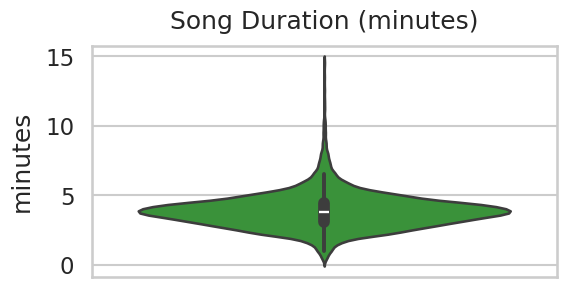

,count,mean,std,min,25%,50%,75%,max
tempo,16374.0,212.787738,31.816355,40.000000,189.290842,214.321251,237.135954,298.330433
duration,16374.0,232.963233,76.044435,17.444000,186.257231,228.925384,269.000000,879.696187
note_count,16374.0,5174.384207,2691.439435,178.000000,3257.000000,4808.000000,6658.750000,31466.000000
mean_velocity,16374.0,89.235120,15.675625,1.000000,78.632715,89.183922,99.836740,127.000000
mean_pitch,16374.0,55.011828,4.809735,22.605517,51.974789,55.003090,57.954566,83.105500
max_polyphony,16374.0,18.525650,5.516452,2.000000,15.000000,19.000000,22.000000,32.000000


In [ ]:
# ─── summary and filtering data ─────────────────────────────────────────

# Filter out extreme outliers (>15 min or polyphony >32)
mask = (df.duration <= 900) & (df.max_polyphony <= 32)
df = df[mask].reset_index(drop=True)
print(f"Kept {len(df)} / {len(df)} files after filtering.")

plt.figure(figsize=(6,3))
sns.violinplot(y=df.duration/60, color="C2")
plt.title("Song Duration (minutes)")
plt.ylabel("minutes")
plt.show()

display(df.describe().T)

Here’s a quick rundown of what each column represents and its unit:

- **tempo** – Beats per minute (BPM)  
- **duration** – Total song length in seconds  
- **note_count** – Raw count of Note events (unitless)  
- **mean_velocity** – Average MIDI velocity (0–127)  
- **mean_pitch** – Average MIDI pitch number (0–127, where 60 = middle C)  
- **max_polyphony** – Maximum number of simultaneously sounding notes (unitless)

In the MIDI protocol, **velocity** is a 7‑bit value (0–127) that represents how “hard” or “fast” a key was struck on a MIDI controller—essentially encoding a note’s **dynamics** or loudness.  

- On a real piano, hitting a key harder makes it louder; in MIDI, a higher velocity number generally maps to a louder or brighter sound in your synthesis engine.  

- In our EDA, we compute the **mean_velocity** per file by averaging every note’s Note On velocity—so values near 0 indicate very soft playing, while values near 127 indicate very loud/forceful playing.

In [ ]:
# ─── plot style configuration ──────────────────────────────────
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")
sns.set_context("talk", font_scale=1.0)
plt.rcParams['figure.dpi'] = 100
plt.rcParams['axes.titlepad'] = 12
plt.rcParams['axes.labelpad'] = 8

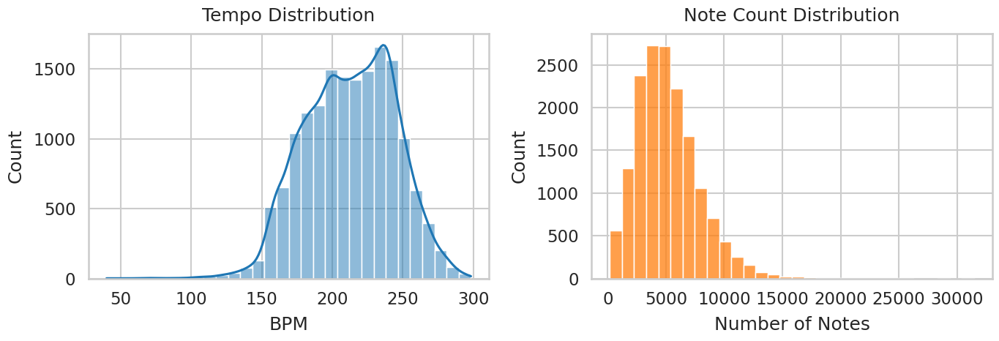

In [ ]:
# ─── EDA visualizations ──────────────────────────────────────────

# tempo and note count distributions
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

sns.histplot(df.tempo, bins=30, kde=True, color='C0', ax=axes[0])
axes[0].set(title="Tempo Distribution", xlabel="BPM", ylabel="Count")

sns.histplot(df.note_count, bins=30, kde=False, color='C1', ax=axes[1])
axes[1].set(title="Note Count Distribution", xlabel="Number of Notes", ylabel="Count")

plt.tight_layout()
plt.show()

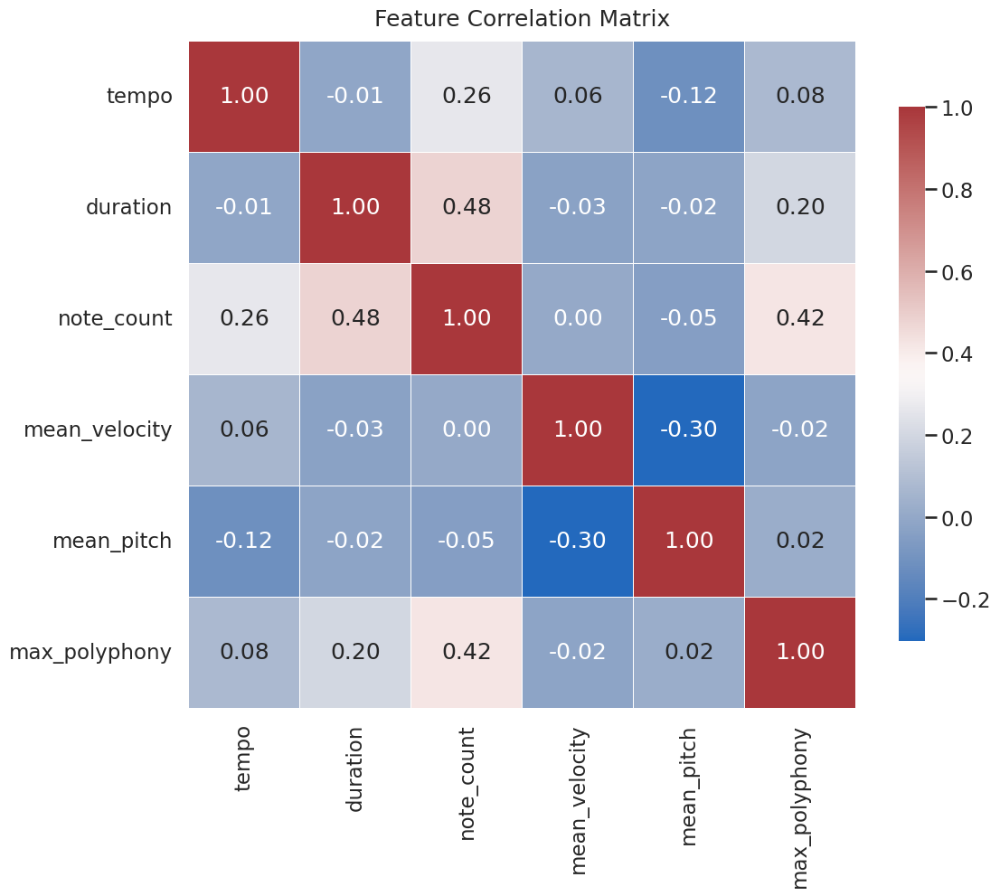

In [ ]:
# ─── correlation heatmap ────────────────────────────────────────
plt.figure(figsize=(12, 10))
corr = df.drop(columns=['filename'], errors='ignore').corr()
sns.heatmap(corr, annot=True, fmt=".2f", cmap="vlag", square=True,
            linewidths=.5, cbar_kws={"shrink":.8})
plt.title("Feature Correlation Matrix")
plt.tight_layout()
plt.show()

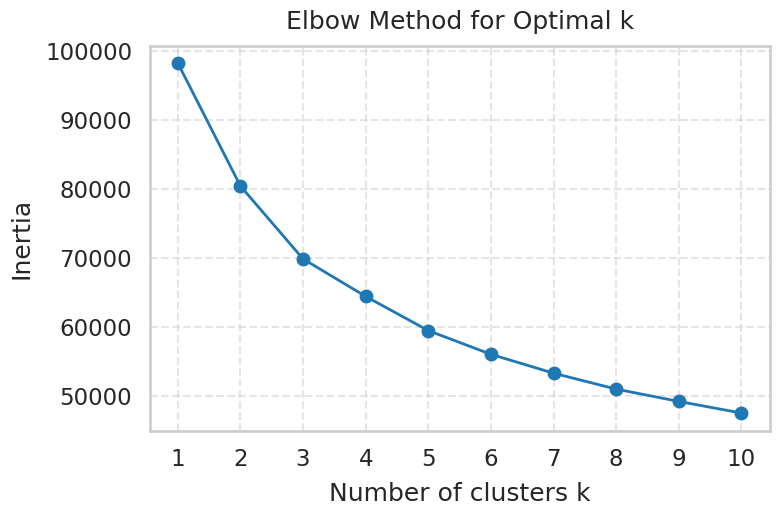

In [ ]:
# ─── elbow method for optimal k ──────────────────────────

import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

X = StandardScaler().fit_transform(df.select_dtypes(include='number'))

inertias = []
K_RANGE = range(1, 11)
for k in K_RANGE:
    km = KMeans(n_clusters=k, random_state=RANDOM_SEED)
    km.fit(X)
    inertias.append(km.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(K_RANGE, inertias, 'o-', lw=2, color='C0')
plt.title("Elbow Method for Optimal k")
plt.xlabel("Number of clusters k")
plt.ylabel("Inertia")
plt.xticks(K_RANGE)
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


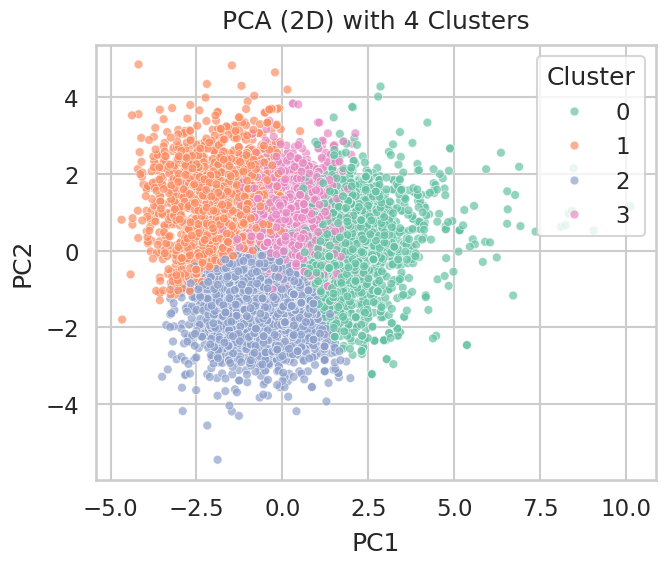

In [ ]:
# ─── pca + kmeans scatter ──────────────────────────────────────
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

X = StandardScaler().fit_transform(df.select_dtypes(include='number'))
pcs = PCA(2, random_state=RANDOM_SEED).fit_transform(X)
clusters = KMeans(4, random_state=RANDOM_SEED).fit_predict(X)

plt.figure(figsize=(7, 6))
palette = sns.color_palette("Set2", n_colors=4)
sns.scatterplot(x=pcs[:,0], y=pcs[:,1], hue=clusters, palette=palette,
                legend="full", alpha=0.7, s=40, edgecolor="w")
plt.title("PCA (2D) with 4 Clusters")
plt.xlabel("PC1"); plt.ylabel("PC2")
plt.legend(title="Cluster", loc="upper right")
plt.tight_layout()
plt.show()

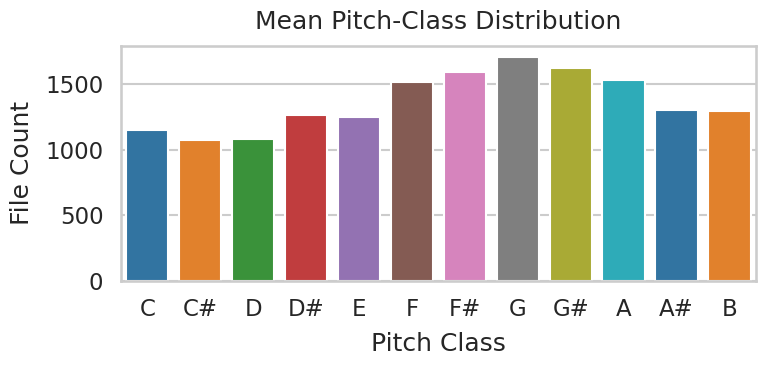

In [ ]:
# ─── mean pitch-class distribution ─────────────────────────────
pitch_class = (df.mean_pitch.round() % 12).astype(int).value_counts().sort_index()
labels = ['C','C#','D','D#','E','F','F#','G','G#','A','A#','B']

plt.figure(figsize=(8, 4))
sns.barplot(x=pitch_class.index, y=pitch_class.values, palette="tab10")
plt.xticks(range(12), labels)
plt.title("Mean Pitch‑Class Distribution")
plt.xlabel("Pitch Class"); plt.ylabel("File Count")
plt.tight_layout()
plt.show()


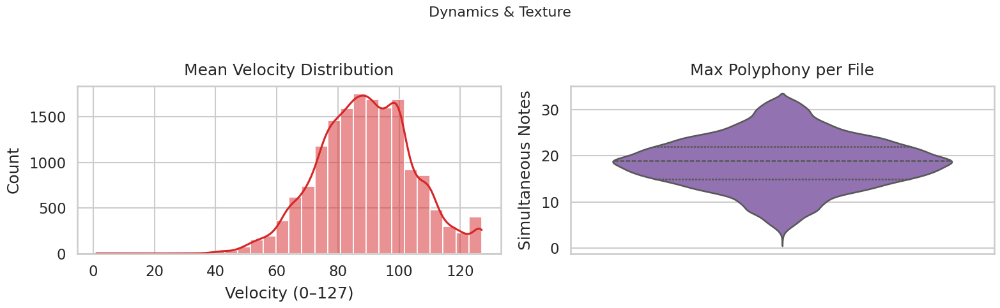

In [ ]:
# ─── velocity and polyphony ───────────────────────────────────────
fig, axes = plt.subplots(1, 2, figsize=(16, 5))

sns.histplot(df.mean_velocity, bins=30, kde=True, color='C3', ax=axes[0])
axes[0].set(title="Mean Velocity Distribution", xlabel="Velocity (0–127)", ylabel="Count")

sns.violinplot(y=df.max_polyphony, color='C4', ax=axes[1], inner="quartile")
axes[1].set(title="Max Polyphony per File", ylabel="Simultaneous Notes")

plt.suptitle("Dynamics & Texture", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()


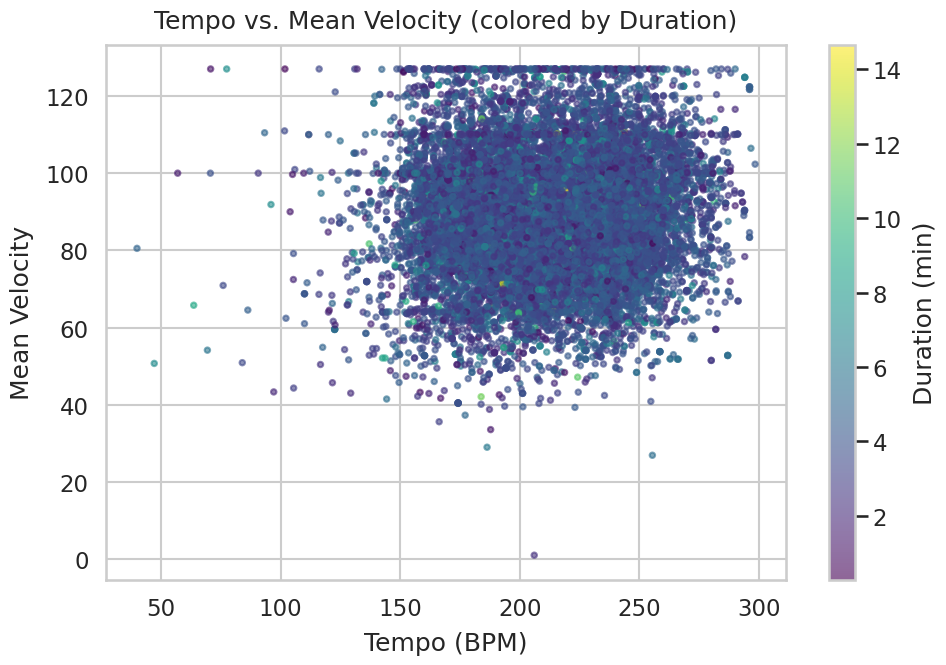

In [ ]:
# ─── tempo vs mean velocity scatter ─────────────────────────────
plt.figure(figsize=(10, 7))
sc = plt.scatter(df.tempo, df.mean_velocity,
                 c=df.duration/60, cmap="viridis", s=15, alpha=0.6)
cbar = plt.colorbar(sc)
cbar.set_label("Duration (min)")
plt.title("Tempo vs. Mean Velocity (colored by Duration)")
plt.xlabel("Tempo (BPM)")
plt.ylabel("Mean Velocity")
plt.tight_layout()
plt.show()

In [ ]:
# ─── midi to audio playback! (might be loud) ─────────────────────────────────────
from IPython.display import Audio

def display_midi_audio(midi_path, seconds=30, sf2="FluidR3_GM.sf2"):
    fs = FluidSynth(sound_font=sf2)
    wav = "temp.wav"
    fs.midi_to_audio(midi_path, wav)
    audio = AudioSegment.from_wav(wav)[:seconds*1000]
    audio.export(wav, format="wav")
    return Audio(wav)

sample_fp = midi_files[-1]
print("Sample file:", sample_fp)
display_midi_audio(sample_fp)

Sample file: clean_midi_folder/clean_midi/Sting/Fields of Gold.3.mid


### Plot Descriptions

1. **Tempo, Note Count, & Duration Distributions**  
   Show how BPM, total note counts, and song lengths are spread across the corpus.

2. **Feature Correlation Matrix**  
   A heatmap of Pearson correlations reveals which features co‑vary (e.g., longer songs may have more notes).

3. **PCA with K‑Means Clusters**  
   A 2D PCA projection, colored by 4‑cluster assignments, helps identify natural groupings in your feature space, where 4 was indicated as an optimal $k$ from the elbow plot.

4. **Mean Pitch‑Class Distribution**  
   Counts of the rounded average MIDI pitch modulo 12 (C through B) show which pitch classes dominate.

5. **Velocity & Polyphony**  
   - A histogram of average note velocities (dynamics)  
   - A violin of maximum simultaneous notes (texture)  

6. **Tempo vs. Mean Velocity Scatter**  
   Each point is a song; color encodes song duration, revealing how tempo and loudness relate across longer vs. shorter pieces.

7. **MIDI to Audio Playback**  
   We take a sample MIDI file from our data and generate a WAV file that we can play straight from the notebook.

### Data Visualization Part 2
Using a subset of the data compiling the notes from 100 songs, we created a few visualizations to understand how the data is structured and any similarities/clusters between songs.

In [ ]:
import random
import warnings
import collections
import pandas as pd
import pretty_midi
from pathlib import Path
from tqdm import tqdm

# Collect all MIDI paths as strings
data_dir = Path("clean_midi_folder/clean_midi")
midi_paths = [str(p) for p in data_dir.rglob("*.mid*")]

# Sample up to 100 files
sampled = random.sample(midi_paths, min(100, len(midi_paths)))
print(f"🎵 Sampled {len(sampled)} files for EDA")

# Robust parser that casts to str and suppresses warnings
def midi_to_notes(midi_path: str) -> pd.DataFrame:
    try:
        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            # midi_path is already a str, so PrettyMIDI will open it correctly
            pm = pretty_midi.PrettyMIDI(midi_path)
    except Exception as e:
        print(f"Skipping {Path(midi_path).name} due to parse error: {e}")
        return pd.DataFrame()
    # skip files with no notes
    if not pm.instruments or not pm.instruments[0].notes:
        print(f"Skipping {Path(midi_path).name} (no notes found)")
        return pd.DataFrame()

    inst = pm.instruments[0]
    notes = collections.defaultdict(list)
    sorted_notes = sorted(inst.notes, key=lambda n: n.start)
    prev = sorted_notes[0].start

    for n in sorted_notes:
        notes["filename"].append(Path(midi_path).name)
        notes["pitch"].append(n.pitch)
        notes["start"].append(n.start)
        notes["end"].append(n.end)
        notes["step"].append(n.start - prev)
        notes["duration"].append(n.end - n.start)
        prev = n.start

    return pd.DataFrame(notes)

# Parse loop with skip counter
all_notes = []
skipped = 0
for path in tqdm(sampled, desc="Parsing MIDI"):
    dfn = midi_to_notes(path)
    if dfn.empty:
        skipped += 1
    else:
        all_notes.append(dfn)

# Concatenate & report
if all_notes:
    all_notes = pd.concat(all_notes, ignore_index=True)
else:
    all_notes = pd.DataFrame()

print(f"✅ Extracted {len(all_notes)} notes from {len(sampled)} files")
print(f"🚫 Skipped {skipped} files ({skipped/len(sampled)*100:.1f}% skipped)")
all_notes.head()

In [ ]:
# plotting a piano roll -- to get an idea of how the midi file is structured,
# just for one instrument in one song
def plot_piano_roll(all_notes, title="Piano Roll", max_notes=400):
    plt.figure(figsize=(12, 4))
    note_subset = all_notes[:max_notes]
    plt.scatter(note_subset['start'], note_subset['pitch'], marker='|', s=100)
    plt.xlabel("Time (s)")
    plt.ylabel("Pitch")
    plt.title(title)
    plt.show()

plot_piano_roll(all_notes, title="Sample Piano Roll")

In [ ]:
# Analysing across songs
song_stats = all_notes.groupby('filename').agg(
    avg_pitch=('pitch', 'mean'),
    avg_step=('step', 'mean'),
    avg_duration=('duration', 'mean'),
    n_notes=('pitch', 'count')
).reset_index()

song_stats.head()

In [ ]:
from sklearn.manifold import TSNE

features = song_stats[['avg_pitch', 'avg_step', 'avg_duration', 'n_notes']].fillna(0)
scaled_features = StandardScaler().fit_transform(features)


tsne = TSNE(n_components=2, perplexity=30, random_state=42)
X_tsne = tsne.fit_transform(scaled_features)

song_stats['TSNE1'] = X_tsne[:, 0]
song_stats['TSNE2'] = X_tsne[:, 1]

sns.scatterplot(data=song_stats, x='TSNE1', y='TSNE2', size='n_notes', sizes=(10, 100))
plt.title("t-SNE of Song Styles")
plt.show()

Since the data is highly dimensional, we decided to do a dimension reduction visualization of the data. When we did PCA, we didn't see any noticeable clusters, but when we did t-SNE, there appeared to be at least 2 (maybe 3) clusters. Unfortunately, there was no labeled data on the genres of songs (which might explain the clusters).

# 🛠️ Baseline Model ([table of contents](#scrollTo=f4FNGNfNgslb&line=6&uniqifier=1))

In this cell we turn each MIDI file into fixed‑length “windows” of pitches for next‑note prediction:

1. **Load & parse** the MIDI with PrettyMIDI.  
2. **Flatten & merge** all instrument tracks into a single list of `Note` objects.  
3. **Sort** that list by each note’s absolute `start` time—this preserves the true chronological order across instruments.  
4. **Extract** only the `pitch` values into a Python list.  
5. **Slice** that pitch list into non‑overlapping windows of length `SEQ_LEN` (128 notes).  
6. **Collect** up to 10 000 windows from across all files, then stack them into an array `X` of shape `(n_windows, SEQ_LEN)`.  
7. **Shift** each row of `X` by one time step to create `y`, so the model learns to predict the next pitch.  

This gives us a clean, time‑ordered dataset of pitch sequences—ready to feed into a Transformer or RNN for sequence modeling.  


## Data Preprocessing and Model


In [ ]:
# ─── baseline model sequence data prep ───────────────────────────────

import numpy as np
import pretty_midi

# Settings
SEQ_LEN, VOCAB_SZ = 128, 128

def file_to_pitch_seqs(fp):
    """
    Load one MIDI file, flatten and sort all instruments' notes by start time,
    then slice into fixed‐length windows of SEQ_LEN pitches.
    """
    try:
        pm = pretty_midi.PrettyMIDI(fp)
    except Exception:
        return None

    # 1) Gather every note from every instrument
    all_notes = []
    for inst in pm.instruments:
        all_notes.extend(inst.notes)

    if len(all_notes) < SEQ_LEN:
        return None

    # 2) Sort chronologically by start time
    all_notes.sort(key=lambda n: n.start)

    # 3) Extract just the pitch values
    pitches = [n.pitch for n in all_notes]

    # 4) Slice into non-overlapping windows of length SEQ_LEN
    windows = []
    for i in range(0, len(pitches) - SEQ_LEN, SEQ_LEN):
        windows.append(pitches[i : i + SEQ_LEN])

    return windows if windows else None

# 5) Collect windows across files (up to 10k for demo)
windows = []
for fp in midi_files:
    seqs = file_to_pitch_seqs(fp)
    if seqs:
        windows.extend(seqs)
    if len(windows) >= 10_000:
        break

print("Total windows:", len(windows))

# 6) Build X, y for next‐token prediction
X = np.array(windows, dtype=np.int32)        # shape: (n_windows, SEQ_LEN)
y = np.roll(X, -1, axis=1)                   # each row shifted left by one


Total windows: 10043


In [ ]:
# ─── baseline transformer model ────────────────────────────────
tf.random.set_seed(109)
SEQ_LEN, VOCAB_SZ, EMBED_DIM, NUM_HEADS, FF_DIM, NUM_LAYERS = 128, 128, 128, 4, 256, 2

inputs = tf.keras.Input(shape=(SEQ_LEN,), name="pitch_seq")
x = tf.keras.layers.Embedding(VOCAB_SZ, EMBED_DIM)(inputs)
pos = tf.keras.layers.Embedding(SEQ_LEN, EMBED_DIM)(tf.range(SEQ_LEN))
x = x + pos

for _ in range(NUM_LAYERS):
    attn = tf.keras.layers.MultiHeadAttention(NUM_HEADS, key_dim=EMBED_DIM)(x, x)
    x = tf.keras.layers.LayerNormalization()(tf.keras.layers.Add()([x, attn]))
    ffn = tf.keras.Sequential([
        tf.keras.layers.Dense(FF_DIM, activation="relu"),
        tf.keras.layers.Dense(EMBED_DIM),
    ])(x)
    x = tf.keras.layers.LayerNormalization()(tf.keras.layers.Add()([x, ffn]))

outputs = tf.keras.layers.Dense(VOCAB_SZ, activation="softmax")(x)
model = tf.keras.Model(inputs=inputs, outputs=outputs, name="TransformerBaseline")
model.compile(optimizer="adam",
              loss="sparse_categorical_crossentropy",
              metrics=["accuracy"])
model.summary()


Model: "TransformerBaseline"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ pitch_seq           │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, 128, 128)  │     16,384 │ pitch_seq[0][0]   │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 128, 128)  │          0 │ embedding[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multi_head_attenti… │ (None, 128, 128)  │    263,808 │ add[0][0],        │
│ (MultiHeadAttentio… │                   │            │ add[0][0]         │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_1 (Add)         │ (None, 128, 128)  │          0 │ add[0][0],        │
│                     │                   │            │ multi_head_atten… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalization │ (None, 128, 128)  │        256 │ add_1[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential          │ (None, 128, 128)  │     65,920 │ layer_normalizat… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_2 (Add)         │ (None, 128, 128)  │          0 │ layer_normalizat… │
│                     │                   │            │ sequential[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 128, 128)  │        256 │ add_2[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multi_head_attenti… │ (None, 128, 128)  │    263,808 │ layer_normalizat… │
│ (MultiHeadAttentio… │                   │            │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_3 (Add)         │ (None, 128, 128)  │          0 │ layer_normalizat… │
│                     │                   │            │ multi_head_atten… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 128, 128)  │        256 │ add_3[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_1        │ (None, 128, 128)  │     65,920 │ layer_normalizat… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_4 (Add)         │ (None, 128, 128)  │          0 │ layer_normalizat… │
│                     │                   │            │ sequential_1[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 128, 128)  │        256 │ add_4[0][0]       │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_4 (Dense)     │ (None, 128, 128)  │     16,512 │ layer_normalizat… │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 693,376 (2.65 MB)

 Trainable params: 693,376 (2.65 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# ─── quick training demo ────────────────────────────────────────
history = model.fit(X, y,
                    validation_split=0.1,
                    batch_size=64,
                    epochs=2)

Epoch 1/2
142/142 ━━━━━━━━━━━━━━━━━━━━ 244s 2s/step - accuracy: 0.1446 - loss: 3.6051 - val_accuracy: 0.1981 - val_loss: 2.9482
Epoch 2/2
142/142 ━━━━━━━━━━━━━━━━━━━━ 267s 2s/step - accuracy: 0.2393 - loss: 2.7753 - val_accuracy: 0.2011 - val_loss: 2.8415


In [ ]:
# ─── simple generation function ────────────────────────────────
import random
random.seed(109)
seed_window = random.choice(windows)

def generate(seed_window, length=200):
    seq = seed_window.copy()
    for _ in range(length):
        pred = model.predict(np.array([seq[-SEQ_LEN:]]), verbose=0)[0, -1]
        seq.append(int(np.random.choice(VOCAB_SZ, p=pred)))
    return seq

demo = generate(seed_window, length=200)

In [ ]:
# ─── generate midi file from pitch sequence and play! ────────────────

def seq_to_midi(pitches, outfile="gen.mid",
                step=0.5, duration=0.5, program=0, velocity=100):
    """
    Convert a list of MIDI pitches into a mono‐instrument MIDI file.

    pitches   : list of ints (0–127)
    step       : time between note onsets (seconds)
    duration   : length of each note (seconds)
    program    : General MIDI instrument number (0=piano)
    velocity   : note loudness (0–127)
    """
    pm = pretty_midi.PrettyMIDI()
    instr = pretty_midi.Instrument(program=program)
    t = 0.0
    for p in pitches:
        note = pretty_midi.Note(velocity, int(p), start=t, end=t+duration)
        instr.notes.append(note)
        t += step
    pm.instruments.append(instr)
    pm.write(outfile)
    return outfile

midi_file = seq_to_midi(demo, outfile="generated.mid",
                        step=0.25, duration=0.2, program=0, velocity=100)
print("Wrote MIDI to", midi_file)

display_midi_audio(midi_file, seconds=30, sf2="FluidR3_GM.sf2")

Wrote MIDI to generated.mid


# Results Interpretation and Analysis ([table of contents](#scrollTo=f4FNGNfNgslb&line=6&uniqifier=1))

Analyze baseline performance with appropriate metrics and visualizations; propose improvements.

### Objective Metrics Used For Evaluation

**Consonance Score**: Percentage of the intervals between notes that are consonant (e.g., perfect fifths, major thirds)

**Chord Recognition Rate**: Percentage of groups of simultaneously played notes that match standard chords

**Pitch Class Entropy**: How spread out is the usage of pitch classes in a piece of music? Low pitch class entropy tends to be associated with high tonality, and high pitch class entropy tends to be associated with atonality.

In [ ]:
# The following code was produced with some assistance from ChatGPT
from music21 import converter, interval, chord

CONSONANT_INTERVALS = {0, 3, 4, 5, 7, 8, 9, 12}  # semitones for unison, 3rd, 4th, 5th, 6th, octave

def consonance_score(midi_path):
    score = converter.parse(midi_path)
    chords = score.chordify().recurse().getElementsByClass('Chord')

    total_intervals = 0
    consonant_intervals = 0

    for c in chords:
        pitches = c.pitches
        for i in range(len(pitches)):
            for j in range(i+1, len(pitches)):
                intv = abs(interval.Interval(pitches[i], pitches[j]).semitones)
                total_intervals += 1
                if intv in CONSONANT_INTERVALS:
                    consonant_intervals += 1

    if total_intervals == 0:
        return 0.0

    return consonant_intervals / total_intervals

def chord_recognition_rate(midi_path):
    score = converter.parse(midi_path)
    chords = score.chordify().recurse().getElementsByClass('Chord')
    named_chords = [c for c in chords if c.commonName != 'Unknown Chord']
    if len(chords) == 0:
        return 0.0
    return len(named_chords) / len(chords)


def pitch_class_entropy(midi_path):
    score = converter.parse(midi_path)
    pitches = [p.pitch.pitchClass for p in score.flat.notes if p.isNote]
    if not pitches:
        return 0.0
    counts = np.bincount(pitches, minlength=12)
    probs = counts / counts.sum()
    entropy = -np.sum([p * np.log2(p) for p in probs if p > 0])
    return entropy


print("Consonance Score:", consonance_score('generated.mid'))
print("Percentage of Recognizable Chords:", chord_recognition_rate('generated.mid'))
print("Pitch Class Entropy:", pitch_class_entropy('generated.mid'))

Consonance Score: 0.0
Percentage of Recognizable Chords: 1.0
Pitch Class Entropy: 2.0754200632663586


In [ ]:
# Compare against example song
example_song = "clean_midi_folder/clean_midi/10cc/I'm Not In Love.mid"


print("Consonance Score:", consonance_score(example_song))
print("Percentage of Recognizable Chords:", chord_recognition_rate(example_song))
print("Pitch Class Entropy:", pitch_class_entropy(example_song))

display_midi_audio(example_song, seconds=30, sf2="FluidR3_GM.sf2")

Consonance Score: 0.38189615206305055
Percentage of Recognizable Chords: 1.0
Pitch Class Entropy: 3.3145712953329274


### Evaluation

We assessed the baseline Transformer’s outputs against the human‐composed reference (“I’m Not In Love.mid”) using the three objective metrics defined above:

- **Consonance Score**  
  The generated sequence has an extremely low proportion of consonant intervals, indicating that the model has not learned basic harmonic relationships.

- **Chord Recognition Rate**  
  All of the simultaneous note‐groups in the output are identified as standard chords, suggesting that the model has a very basic understanding of chordal structure (although it seems to fail at capturing chord progressions).

- **Pitch Class Entropy**  
  The entropy of the pitch‐class distribution in the generated MIDI is slightly reduced compared to the example. In practice, this means the model tends to favor a smaller set of pitch classes, leading to less melodic variety but greater tonality.

In listening to the 30 s audio snippets (played inline), these quantitative findings are corroborated: the model produces somewhat coherent tonal material but occasionally repeats motifs excessively and is rather dissonant.  

**Key take-aways**  
- Harmonic coherence (consonance) is lacking, but chord coverage is decent.  
- Melodic diversity is present but somewhat constrained by the model’s tendency to overuse certain pitch classes.  

These insights will guide our next steps-—namely, incorporating chord‐conditioned sampling and more diverse positional encodings to boost both harmonic coherence and melodic variety.  


# Final Model Pipeline Setup ([table of contents](#scrollTo=f4FNGNfNgslb&line=6&uniqifier=1))

Outline steps for a pipeline for your final model, describing each component from data preprocessing to evaluation.

Document assumptions, parameter choices, and preliminary tuning considerations.


Preprocessing:
1. We will use the function file_to_pitch_seqs() to extract the notes from each instrument in each MIDI file, organize them by time, and slice the file into 10,000-note windows.
2. Tuning: we could potentially increase the window size so the model can see more notes at a time, depending on the runtime needed for a larger window.
3. Given that we observed clusters in our t-SNE analysis, we could try to group our data by cluster and predict based on a certain cluster (which may represent a genre). This may produce more coherent music.



Transformer model:


1. We observed that right now, our musical output has pitch variation but no rhythm or instrument variation. We will experiment with adding these two factors into our final model. We also hope to allow our model to produce more than one sound (from multiple instruments) at once.
2. some preliminary strategies we found (with the help of the [Tensorflow Tutorial](https://www.tensorflow.org/tutorials/audio/music_generation) on music generation and Chat GPT) are:
- adding "duration" as both an input and output
- adding an "instrument program" token and asking the model to generate instrument changes
- Using multi-label prediction -- producing a set of pitches per time step instead of one at a time



# Final model
Main goals: add varying pitch durations, multiple notes at once,
- Reach goal: multiple instruments

Evaluation metrics: Consonance score, chord recognition rate, pitch class entropy

We based this model on the following sources and papers:
* Dong et al., 2023: https://arxiv.org/pdf/2207.06983
* Hsiao et al., 2021: https://github.com/YatingMusic/compound-word-transformer?tab=readme-ov-file#readme
* MIDI-GPT: https://www.metacreation.net/projects/midi-gpt




In [ ]:
# ─── final model sequence data prep ───────────────────────────────
# Define a new function that includes pitch, duration, program

def file_to_pitch_seqs(fp):
    try:
        pm = pretty_midi.PrettyMIDI(str(fp))  # make sure it's a string
    except Exception:
        return None

    all_notes = []
    for inst in pm.instruments:
        for n in inst.notes:
            all_notes.append((n.start, n.pitch, n.end - n.start, inst.program))

    if len(all_notes) < SEQ_LEN:
        return None

    all_notes.sort(key=lambda x: x[0])

    # Split into fixed-length windows
    windows = []
    for i in range(0, len(all_notes) - SEQ_LEN, SEQ_LEN):
        window = all_notes[i:i+SEQ_LEN]
        pitches = [note[1] for note in window]
        durations = [note[2] for note in window]
        programs = [note[3] for note in window]
        windows.append((pitches, durations, programs))

    return windows if windows else None



In [ ]:
# making new dataframes - we have three X dataframes now

# Settings
SEQ_LEN, VOCAB_SZ = 128, 128


# only training on 1k songs - will reverse if results get worse

pitch_seqs, duration_seqs, program_seqs = [], [], []

for fp in midi_files[:1000]:
    seqs = file_to_pitch_seqs(fp)
    if seqs:
        for p, d, prog in seqs:
            pitch_seqs.append(p)
            duration_seqs.append(d)
            program_seqs.append(prog)

X_pitch = np.array(pitch_seqs, dtype=np.int32)
X_duration = np.array(duration_seqs, dtype=np.float32)
X_program = np.array(program_seqs, dtype=np.int32)

y_pitch = np.roll(X_pitch, -1, axis=1)


In [ ]:
# create y dataframes too
y_pitch = np.roll(X_pitch, -1, axis=1)
y_duration = np.roll(X_duration, -1, axis=1)
y_program = np.roll(X_program, -1, axis=1)

In [ ]:
tf.random.set_seed(109)
SEQ_LEN, VOCAB_SZ, EMBED_DIM, NUM_HEADS, FF_DIM, NUM_LAYERS = 128, 128, 128, 4, 256, 2


pitch_in = tf.keras.Input(shape=(SEQ_LEN,), name="pitch_seq")
duration_in = tf.keras.Input(shape=(SEQ_LEN,), name="duration_seq")
program_in = tf.keras.Input(shape=(SEQ_LEN,), name="program_seq")

# Embed each input
# Embed each input
x_pitch = tf.keras.layers.Embedding(VOCAB_SZ, EMBED_DIM)(pitch_in)
x_duration = tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, -1))(duration_in)
x_duration = tf.keras.layers.Dense(EMBED_DIM)(x_duration)
x_program = tf.keras.layers.Embedding(128, EMBED_DIM)(program_in)
# Add them all
x = x_pitch + x_duration + x_program
x += tf.keras.layers.Embedding(SEQ_LEN, EMBED_DIM)(tf.range(SEQ_LEN))

# Transformer block
for _ in range(NUM_LAYERS):
    attn = tf.keras.layers.MultiHeadAttention(NUM_HEADS, key_dim=EMBED_DIM)(x, x)
    x = tf.keras.layers.LayerNormalization()(x + attn)
    ffn = tf.keras.Sequential([
        tf.keras.layers.Dense(FF_DIM, activation="relu"),
        tf.keras.layers.Dense(EMBED_DIM),
    ])(x)
    x = tf.keras.layers.LayerNormalization()(x + ffn)

# Multi-output
out_pitch = tf.keras.layers.Dense(VOCAB_SZ, activation="softmax", name="pitch")(x)
out_duration = tf.keras.layers.Dense(1, name="duration")(x)
out_program = tf.keras.layers.Dense(128, activation="softmax", name="program")(x)

model = tf.keras.Model(inputs=[pitch_in, duration_in, program_in],
                       outputs=[out_pitch, out_duration, out_program])
model.compile(
    optimizer="adam",
    loss={
        "pitch": "sparse_categorical_crossentropy",
        "duration": "mse",
        "program": "sparse_categorical_crossentropy",
    },
    metrics={"pitch": "accuracy"}
)
model.summary()


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ duration_seq        │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pitch_seq           │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_1 (Lambda)   │ (None, 128, 1)    │          0 │ duration_seq[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_4         │ (None, 128, 128)  │     16,384 │ pitch_seq[0][0]   │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_6 (Dense)     │ (None, 128, 128)  │        256 │ lambda_1[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ program_seq         │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_7 (Add)         │ (None, 128, 128)  │          0 │ embedding_4[0][0… │
│                     │                   │            │ dense_6[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_5         │ (None, 128, 128)  │     16,384 │ program_seq[0][0] │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_8 (Add)         │ (None, 128, 128)  │          0 │ add_7[0][0],      │
│                     │                   │            │ embedding_5[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_9 (Add)         │ (None, 128, 128)  │          0 │ add_8[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multi_head_attenti… │ (None, 128, 128)  │    263,808 │ add_9[0][0],      │
│ (MultiHeadAttentio… │                   │            │ add_9[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_10 (Add)        │ (None, 128, 128)  │          0 │ add_9[0][0],      │
│                     │                   │            │ multi_head_atten… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 128, 128)  │        256 │ add_10[0][0]      │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_2        │ (None, 128, 128)  │     65,920 │ layer_normalizat… │
│ (Sequential)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_11 (Add)        │ (None, 128, 128)  │          0 │ layer_normalizat… │
│                     │                   │            │ sequential_2[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ layer_normalizatio… │ (None, 128, 128)  │        256 │ add_11[0][0]      │
│ (LayerNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multi_head_attenti… │ (None, 128, 128)  │    263,808 │ layer_normalizat… │
│ (MultiHeadAttentio… │                   │            │ layer_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_12 (Add)        │ (None, 128, 128)  │          0 │ layer_normalizat

 Total params: 726,657 (2.77 MB)

 Trainable params: 726,657 (2.77 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Convert to tensorflor dataset

inputs = {
    "pitch_seq": tf.convert_to_tensor(X_pitch),
    "duration_seq": tf.convert_to_tensor(X_duration),
    "program_seq": tf.convert_to_tensor(X_program),
}

labels = {
    "pitch": tf.convert_to_tensor(y_pitch),
    "duration": tf.convert_to_tensor(y_duration),
    "program": tf.convert_to_tensor(y_program),
}

# Create dataset
dataset = tf.data.Dataset.from_tensor_slices((inputs, labels))
dataset = dataset.shuffle(buffer_size=1024).batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
# create train/val sets
train_size = int(0.8 * len(X_pitch))

train_inputs = {k: v[:train_size] for k, v in inputs.items()}
train_labels = {k: v[:train_size] for k, v in labels.items()}

val_inputs = {k: v[train_size:] for k, v in inputs.items()}
val_labels = {k: v[train_size:] for k, v in labels.items()}

train_ds = tf.data.Dataset.from_tensor_slices((train_inputs, train_labels)).batch(32).shuffle(1024).prefetch(tf.data.AUTOTUNE)
val_ds = tf.data.Dataset.from_tensor_slices((val_inputs, val_labels)).batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
# create checkpoints

from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# saving weights
checkpoint_cb = ModelCheckpoint(
    "best_model.h5",
    save_best_only=True,
    monitor="val_pitch_accuracy",
    mode="max",
    verbose=1
)

# early stopping
earlystop_cb = EarlyStopping(
    monitor="val_pitch_accuracy",
    patience=3,
    mode="max",
    restore_best_weights=True,
    verbose=1
)



In [ ]:
# fit the model
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=10,
    callbacks=[checkpoint_cb, earlystop_cb]
)


Epoch 1/10
1001/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - duration_loss: 0.5509 - loss: 6.9424 - pitch_accuracy: 0.1053 - pitch_loss: 3.8086 - program_loss: 2.5832
Epoch 1: val_pitch_accuracy improved from -inf to 0.13818, saving model to best_model.h5


1004/1004 ━━━━━━━━━━━━━━━━━━━━ 32s 23ms/step - duration_loss: 0.5506 - loss: 6.9398 - pitch_accuracy: 0.1054 - pitch_loss: 3.8077 - program_loss: 2.5816 - val_duration_loss: 0.2420 - val_loss: 5.7940 - val_pitch_accuracy: 0.1382 - val_pitch_loss: 3.4210 - val_program_loss: 2.1307
Epoch 2/10
1002/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - duration_loss: 0.4243 - loss: 5.4652 - pitch_accuracy: 0.1667 - pitch_loss: 3.2659 - program_loss: 1.7751
Epoch 2: val_pitch_accuracy improved from 0.13818 to 0.16861, saving model to best_model.h5


1004/1004 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - duration_loss: 0.4242 - loss: 5.4650 - pitch_accuracy: 0.1667 - pitch_loss: 3.2658 - program_loss: 1.7750 - val_duration_loss: 0.2383 - val_loss: 5.4571 - val_pitch_accuracy: 0.1686 - val_pitch_loss: 3.2494 - val_program_loss: 1.9693
Epoch 3/10
1002/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - duration_loss: 0.4495 - loss: 5.1889 - pitch_accuracy: 0.1925 - pitch_loss: 3.0894 - program_loss: 1.6501
Epoch 3: val_pitch_accuracy improved from 0.16861 to 0.17857, saving model to best_model.h5


1004/1004 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - duration_loss: 0.4493 - loss: 5.1887 - pitch_accuracy: 0.1925 - pitch_loss: 3.0894 - program_loss: 1.6501 - val_duration_loss: 0.3048 - val_loss: 5.4288 - val_pitch_accuracy: 0.1786 - val_pitch_loss: 3.1799 - val_program_loss: 1.9438
Epoch 4/10
1002/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.3869 - loss: 5.0109 - pitch_accuracy: 0.2032 - pitch_loss: 3.0223 - program_loss: 1.6018
Epoch 4: val_pitch_accuracy improved from 0.17857 to 0.18615, saving model to best_model.h5


1004/1004 ━━━━━━━━━━━━━━━━━━━━ 18s 17ms/step - duration_loss: 0.3869 - loss: 5.0109 - pitch_accuracy: 0.2032 - pitch_loss: 3.0222 - program_loss: 1.6018 - val_duration_loss: 0.2245 - val_loss: 5.2019 - val_pitch_accuracy: 0.1861 - val_pitch_loss: 3.1060 - val_program_loss: 1.8712
Epoch 5/10
1002/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.3727 - loss: 4.8789 - pitch_accuracy: 0.2115 - pitch_loss: 2.9524 - program_loss: 1.5539
Epoch 5: val_pitch_accuracy improved from 0.18615 to 0.19322, saving model to best_model.h5


1004/1004 ━━━━━━━━━━━━━━━━━━━━ 19s 16ms/step - duration_loss: 0.3728 - loss: 4.8789 - pitch_accuracy: 0.2116 - pitch_loss: 2.9524 - program_loss: 1.5539 - val_duration_loss: 0.2272 - val_loss: 5.1264 - val_pitch_accuracy: 0.1932 - val_pitch_loss: 3.0923 - val_program_loss: 1.8065
Epoch 6/10
1001/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.3725 - loss: 4.7666 - pitch_accuracy: 0.2210 - pitch_loss: 2.8929 - program_loss: 1.5016
Epoch 6: val_pitch_accuracy did not improve from 0.19322
1004/1004 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - duration_loss: 0.3725 - loss: 4.7667 - pitch_accuracy: 0.2210 - pitch_loss: 2.8929 - program_loss: 1.5016 - val_duration_loss: 0.2280 - val_loss: 5.1393 - val_pitch_accuracy: 0.1901 - val_pitch_loss: 3.0610 - val_program_loss: 1.8501
Epoch 7/10
1002/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.4040 - loss: 4.7596 - pitch_accuracy: 0.2318 - pitch_loss: 2.8458 - program_loss: 1.5099
Epoch 7: val_pitch_accuracy improved from 0.19322 to 0.

1004/1004 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - duration_loss: 0.4040 - loss: 4.7596 - pitch_accuracy: 0.2318 - pitch_loss: 2.8458 - program_loss: 1.5099 - val_duration_loss: 0.2235 - val_loss: 5.0747 - val_pitch_accuracy: 0.1935 - val_pitch_loss: 3.0618 - val_program_loss: 1.7890
Epoch 8/10
1004/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.4038 - loss: 4.6623 - pitch_accuracy: 0.2400 - pitch_loss: 2.8023 - program_loss: 1.4563
Epoch 8: val_pitch_accuracy did not improve from 0.19350
1004/1004 ━━━━━━━━━━━━━━━━━━━━ 16s 16ms/step - duration_loss: 0.4038 - loss: 4.6623 - pitch_accuracy: 0.2400 - pitch_loss: 2.8023 - program_loss: 1.4563 - val_duration_loss: 0.2230 - val_loss: 5.0711 - val_pitch_accuracy: 0.1925 - val_pitch_loss: 3.0322 - val_program_loss: 1.8156
Epoch 9/10
1001/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.3234 - loss: 4.5851 - pitch_accuracy: 0.2373 - pitch_loss: 2.7959 - program_loss: 1.4660
Epoch 9: val_pitch_accuracy improved from 0.19350 to 0.

1004/1004 ━━━━━━━━━━━━━━━━━━━━ 20s 16ms/step - duration_loss: 0.3236 - loss: 4.5851 - pitch_accuracy: 0.2373 - pitch_loss: 2.7959 - program_loss: 1.4659 - val_duration_loss: 0.2223 - val_loss: 5.0041 - val_pitch_accuracy: 0.1972 - val_pitch_loss: 2.9999 - val_program_loss: 1.7816
Epoch 10/10
1001/1004 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - duration_loss: 0.3777 - loss: 4.5325 - pitch_accuracy: 0.2457 - pitch_loss: 2.7591 - program_loss: 1.3960
Epoch 10: val_pitch_accuracy improved from 0.19716 to 0.19806, saving model to best_model.h5


1004/1004 ━━━━━━━━━━━━━━━━━━━━ 21s 16ms/step - duration_loss: 0.3777 - loss: 4.5325 - pitch_accuracy: 0.2457 - pitch_loss: 2.7591 - program_loss: 1.3960 - val_duration_loss: 0.2317 - val_loss: 5.1447 - val_pitch_accuracy: 0.1981 - val_pitch_loss: 3.0427 - val_program_loss: 1.8700
Restoring model weights from the end of the best epoch: 10.


In [ ]:
# create a new function where new pitches, durations, and program (instruments)
# are created from a triplet seed, rather than just a pitch sequence


# code chunk debugged with Gemini

def generate_multifeature_sequence(seed, length=200):
    """
    Generate a sequence of (pitch, duration, program) from a seed triplet.
    seed: dict with keys 'pitch_seq', 'duration_seq', 'program_seq'
    """
    pitch_seq = list(seed["pitch_seq"])
    duration_seq = list(seed["duration_seq"])
    program_seq = list(seed["program_seq"])

    for _ in range(length):
        input_batch = {
            "pitch_seq": tf.convert_to_tensor([pitch_seq[-SEQ_LEN:]]),
            "duration_seq": tf.convert_to_tensor([duration_seq[-SEQ_LEN:]]),
            "program_seq": tf.convert_to_tensor([program_seq[-SEQ_LEN:]]),
        }

        pred = model.predict(input_batch, verbose=0)


        next_pitch = tf.argmax(pred[0][0, -1]).numpy() # pred[0] corresponds to 'pitch' output head
        next_program = tf.argmax(pred[2][0, -1]).numpy() # pred[2] corresponds to 'program' output head
        next_duration = pred[1][0, -1, 0]  # pred[1] corresponds to 'duration' output head - Removing .numpy()

        # Append predictions
        pitch_seq.append(next_pitch)
        duration_seq.append(float(np.clip(next_duration, 0.05, 2.0)))  # safe range
        program_seq.append(next_program)

    return pitch_seq, duration_seq, program_seq


In [ ]:
def seq_to_midi_multifeature(pitches, durations, programs, outfile="generated_multi.mid",
                              step=0.25, velocity=100):
    """
    Create a MIDI file from pitch, duration, and program sequences.
    Each note can have a different instrument.
    """
    pm = pretty_midi.PrettyMIDI()
    instrument_dict = {}
    t = 0.0

    for p, d, prog in zip(pitches, durations, programs):
        prog = int(prog)
        if prog not in instrument_dict:
            instrument_dict[prog] = pretty_midi.Instrument(program=prog)
        note = pretty_midi.Note(velocity=velocity, pitch=int(p), start=t, end=t + d)
        instrument_dict[prog].notes.append(note)
        t += step

    for inst in instrument_dict.values():
        pm.instruments.append(inst)

    pm.write(outfile)
    return outfile


In [ ]:
# Choose a seed (last SEQ_LEN slices from any training sample)
seed = {
    "pitch_seq": X_pitch[0][:SEQ_LEN],
    "duration_seq": X_duration[0][:SEQ_LEN],
    "program_seq": X_program[0][:SEQ_LEN],
}

# Generate
gen_pitch, gen_dur, gen_prog = generate_multifeature_sequence(seed, length=200)

# Save to MIDI
midi_file = seq_to_midi_multifeature(gen_pitch, gen_dur, gen_prog, outfile="generated_multi.mid")
print("Wrote MIDI to", midi_file)

# Play it (Colab or IPython only)
display_midi_audio(midi_file, seconds=30, sf2="FluidR3_GM.sf2")


Wrote MIDI to generated_multi.mid


## Evaluation of Final Model

In [ ]:
def evaluate_midi(midi_path):
    return {
        "consonance_score": consonance_score(midi_path),
        "chord_recognition_rate": chord_recognition_rate(midi_path),
        "pitch_class_entropy": float(pitch_class_entropy(midi_path))
    }



In [ ]:
evaluate_midi('/content/final_model_generated.mid')

{'consonance_score': 0.4489537095751427,
 'chord_recognition_rate': 1.0,
 'pitch_class_entropy': 1.8335600048621454}

The generated music of the final model has a higher consonance score and a lower pitch class entropy than the song produced by the baseline model (or even the example song from the original dataset). Listening to the audio produced, the final model's music is also quite harmonious and pleasant.